## Calibration executer

Auteurs : Léa Drolet-Roy

Création : 2025-05-01

Dernière modification : 2025-05-01

In [1]:
import os
import cv2
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import pickle
import toml
import json
import glob
import shutil
from pathlib import Path

from scipy.optimize import minimize

from caleabration.calibration import Calibration
from caleabration.charuco import Charucoboard
from caleabration.checkerboard import Checkerboard

np.set_printoptions(precision=4, suppress=True)

## Initial parameters

In [2]:
image_size = (1280, 720)

# create Checker board object
Board = Checkerboard((7,4), 48)

# create Calibration object
Calib = Calibration(Board, image_size)

cams = ['c1', 'c2', 'c3', 'c4', 'c5', 'c6']

time_threshold = 15

path = r'C:\Users\LEA\Desktop\Poly\Trampo\data_cobotique\calib_0501'
calib_dir = os.path.join(path, 'corners_found')

path_stereo = r'C:\Users\LEA\Desktop\Poly\Trampo\data_cobotique\calib_0501\stereo_confirmed'
path_intrinsics = r'C:\Users\LEA\Desktop\Poly\Trampo\data_cobotique\calib_0501\corners_found'

### Save images with detections

Images saving...
Coverage for cam c1: 59.26%
Coverage for cam c2: 82.20%
Coverage for cam c3: 88.72%
Coverage for cam c4: 79.62%
Coverage for cam c5: 76.95%
Coverage for cam c6: 76.29%
Saved 1868 valid frames.


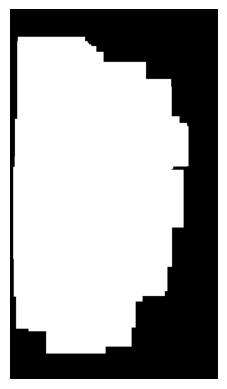

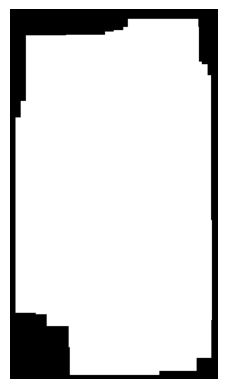

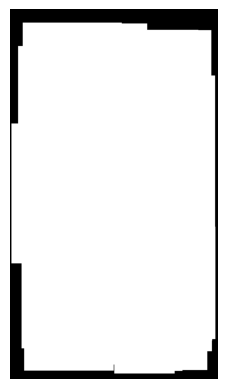

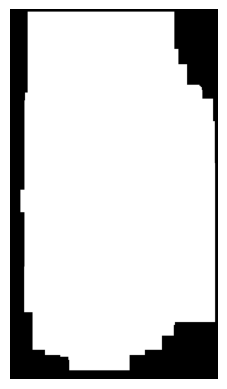

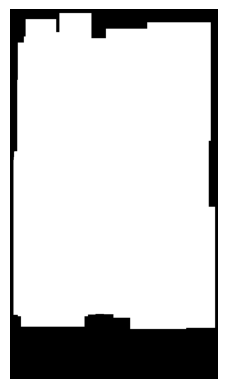

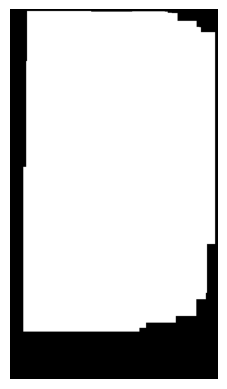

In [3]:
valid_frame_count, total_area_covered, mask_covered = Calib.saveImagesBoard(path, 'png', save_corners=True, dirname='intrinsics', skip=1)

for mask in mask_covered:
    plt.imshow(mask, cmap='gray')
    plt.axis('off') 
    plt.show()
    plt.close()

### Intrinsic calibration

In [3]:
# Try setting an initial camera matrix
w,h = image_size
focal_length = 1200 # Approximate focal length
camera_matrix_init = np.array([
    [focal_length, 0, w / 2],
    [0, focal_length, h / 2],
    [0, 0, 1]], dtype=np.float32)

ret, C, S, D, K = Board.calibrate_intrinsics(calib_dir, image_size, camera_matrix_init)

K = np.array(K)
np.savez('Intrinsics_K_cobotique.npz', K)

D = np.array(D)
np.savez('Intrinsics_D_cobotique.npz', D)

Calibration completed for camera: c1
Error: 0.2583
Camera Matrix:
 [[648.7572   0.     648.4957]
 [  0.     650.546  371.6272]
 [  0.       0.       1.    ]]
Distortion Coefficients:
 [[-0.0486]
 [ 0.063 ]
 [ 0.0017]
 [ 0.0022]
 [-0.0164]]
Calibration completed for camera: c2
Error: 0.2728
Camera Matrix:
 [[658.2324   0.     656.3683]
 [  0.     660.3634 357.4229]
 [  0.       0.       1.    ]]
Distortion Coefficients:
 [[-0.0417]
 [ 0.0641]
 [ 0.0003]
 [ 0.0006]
 [-0.0196]]
Calibration completed for camera: c3
Error: 0.2779
Camera Matrix:
 [[659.966    0.     641.9627]
 [  0.     660.635  363.6401]
 [  0.       0.       1.    ]]
Distortion Coefficients:
 [[-0.0406]
 [ 0.0692]
 [ 0.001 ]
 [ 0.0012]
 [-0.0259]]
Calibration completed for camera: c4
Error: 0.4638
Camera Matrix:
 [[651.6848   0.     650.9045]
 [  0.     652.9255 371.1187]
 [  0.       0.       1.    ]]
Distortion Coefficients:
 [[-0.0491]
 [ 0.0661]
 [ 0.0019]
 [ 0.0039]
 [-0.0204]]
Calibration completed for camera: c5
Err

### Transfo to global reference frame

In [23]:
# Transfo to global reference frame
K_conf = np.load('calib_0425/Intrinsics_K_conf.npz')['arr_0']
D_conf = np.load('calib_0425/Intrinsics_D_conf.npz')['arr_0']

# create Charurco board object
big_Board = Charucoboard(checkerboard=(5,4), square_size=230, marker_size=172, aruco_name=aruco_name, legacy=True)
big_board = big_Board.charuco_board
# create Calibration object
big_Calib = Calibration(big_Board, image_size)

# save images
valid_frame_count, total_area_covered, mask_covered = big_Calib.saveImagesBoard(path_world, 'jpg', dirname='images', save_corners=True, skip=1)

# save stereo data
big_Calib.saveImagePoints(path_world, cams, savename='data_world')

with open('data_world.pkl', 'rb') as f:
    images_world = pickle.load(f)

list_charcuoTcam = []
for cam in cams:
    Params = {}
    camMatrix = K_conf[cams.index(cam)]
    distCoeffs = D_conf[cams.index(cam)]

    corners = [images_world['Charuco_Corners'][i] for i in range(0, len(images_world['Charuco_Corners'])) if images_world['Camera'][i] == cam]
    ids = [images_world['Charuco_Ids'][i] for i in range(0, len(images_world['Charuco_Corners'])) if images_world['Camera'][i] == cam]
    
    corners = [i for sublist in corners for i in sublist]
    ids = [i for sublist in ids for i in sublist]

    if len(corners) >= 2:
        charucoCorners = np.array(corners, dtype=np.float32)
        charucoIds = np.array(ids, dtype=np.int32)

        if camMatrix.size != 0 and distCoeffs.size != 0: # and len(charucoIds) >= 4:
            objPoints, imgPoints = big_board.matchImagePoints(charucoCorners, charucoIds)
            success, rvec, tvec = cv2.solvePnP(objPoints, imgPoints, camMatrix, distCoeffs)

            R, _ = cv2.Rodrigues(rvec)
            t = tvec.reshape(3,1)
            camTcharuco = np.vstack([np.hstack([R,t]), np.array([0,0,0,1])])
            charucoTcam = np.linalg.inv(camTcharuco)
            print(charucoTcam)
            list_charcuoTcam.append(charucoTcam)

            # Project the 3D object points to 2D using the estimated pose
            projectedPoints, _ = cv2.projectPoints(objPoints, rvec, tvec, camMatrix, distCoeffs)

            # Compute reprojection error (Euclidean distance between observed and projected points)
            errors = np.linalg.norm(imgPoints - projectedPoints.squeeze(), axis=1)
            mean_error = np.mean(errors)
            print(cam, 'RMSE =', mean_error, 'pixels  dist =', np.linalg.norm(tvec)/1000, 'm')


Images saving...
Coverage for cam M11139: 0.89%
Coverage for cam M11140: 0.35%
Coverage for cam M11141: 0.00%
Coverage for cam M11458: 0.26%
Coverage for cam M11459: 0.66%
Coverage for cam M11461: 0.00%
Coverage for cam M11462: 0.00%
Coverage for cam M11463: 0.00%
Saved 66 valid frames.
[[   -0.1767     0.6423    -0.7458  4518.4339]
 [   -0.011     -0.759     -0.651   3728.3825]
 [   -0.9842    -0.1068     0.1412 -3382.9559]
 [    0.         0.         0.         1.    ]]
M11139 RMSE = 828.20935 pixels  dist = 6.764722562053943 m
[[   -0.039     -0.9592    -0.2801  1661.8166]
 [    0.0479    -0.2818     0.9583 -6555.8841]
 [   -0.9981     0.0239     0.057  -3909.989 ]
 [    0.         0.         0.         1.    ]]
M11140 RMSE = 479.61404 pixels  dist = 7.81212290971305 m
[[   -0.0915     0.9554     0.2807 -1591.6007]
 [   -0.427     -0.2923     0.8557 -6395.409 ]
 [    0.8996    -0.0415     0.4347 -3873.4866]
 [    0.         0.         0.         1.    ]]
M11458 RMSE = 288.55823 pixe

In [24]:
world_t_charuco = np.array([0, 0, 1200]).reshape((3,1))
world_R_charuco = np.array([[1,0,0],
                            [0,-1,0],
                            [0,0,-1]])
#print(np.linalg.det(world_R_charuco))
worldTcharuco = np.vstack([np.hstack([world_R_charuco, world_t_charuco]), np.array([0,0,0,1])])
#print(worldTcharuco)

list_worldTcam = []
for camTcharuco in list_charcuoTcam:
    worldTcam = worldTcharuco @ camTcharuco
    list_worldTcam.append(worldTcam)

np.savez('WorldTcam_charuco.npz', list_worldTcam)

### Save stereo data

In [ ]:
# Board.find_matching_images(path, 'u101', cams, time_threshold, path_stereo, path_intrinsics)
# Board.find_matching_images(path, 'u102', cams, time_threshold, path_stereo, path_intrinsics)

def saveStereoData(path, cams, savename='stereo_data'):
    # Create array of all stereo images with 'im_name, img_pts, cam_ timestamp'
    stereo_images = {'Name':[], 'Camera':[], 'Charuco_Corners':[], 'Charuco_Ids':[]}
    path_corners = os.path.join(path, 'corners_found')

    # maximal number of images per camera pair
    Nmax = 100

    for cam1 in cams:
        path_cam1 = os.path.join(path_corners, cam1)
        cali1 = Board.retrieve_cali_info(path, cam1[-1])

        for cam2 in cams[cams.index(cam1)+1:]:
            path_cam2 = os.path.join(path_corners, cam2)
            cali2 = Board.retrieve_cali_info(path, cam2[-1])

            im_saved = 0
            for name1 in os.listdir(path_cam1):
                user1 = name1.split('_')[2][1:]
                i = np.intersect1d(np.where(user1 == cali1[0,:])[0], np.where(name1.split(cam1)[-1] == cali1[1,:])[0])[0]
                t1 = float(cali1[2,i])

                for name2 in os.listdir(path_cam2):
                    user2 = name2.split('_')[2][1:]

                    if user1 != user2:
                        continue

                    j = np.intersect1d(np.where(user2 == cali2[0,:])[0], np.where(name2.split(cam2)[-1] == cali2[1,:])[0])[0]
                    t2 = float(cali2[2,j])
                    
                    #print(t1, t2)

                    if abs(t1 - t2) < time_threshold:
                        Lret, _, _, LcharucoCorners, LcharucoIds = Board.findCorners(im_name=os.path.join(path_cam1, name1))
                        Rret, _, _, RcharucoCorners, RcharucoIds = Board.findCorners(im_name=os.path.join(path_cam2, name2))

                        Ncommon_ids = 0
                        if Board.type == 'charuco' and Lret and Rret:
                            _, _, _, common_ids = Board.getObjectImagePoints(LcharucoCorners, LcharucoIds, RcharucoCorners, RcharucoIds)
                            if common_ids is not None:
                                Ncommon_ids = len(common_ids)

                        if Board.type == 'checker' or Ncommon_ids >= 6:
                            stereo_images['Name'].append(name1)
                            stereo_images['Camera'].append(cam1)
                            stereo_images['Charuco_Corners'].append(LcharucoCorners)
                            stereo_images['Charuco_Ids'].append(LcharucoIds)

                            stereo_images['Name'].append(name2)
                            stereo_images['Camera'].append(cam2)
                            stereo_images['Charuco_Corners'].append(RcharucoCorners)
                            stereo_images['Charuco_Ids'].append(RcharucoIds)

                            im_saved += 1
                
                    if im_saved >= Nmax:
                        break
            
            print(cam1, cam2, im_saved)
        
    with open(savename + '.pkl', 'wb') as f:
        pickle.dump(stereo_images, f)
    return

saveStereoData(path, cams)

c1 c2 6
c1 c3 8
c1 c4 25
c1 c5 7
c1 c6 41
c2 c3 26
c2 c4 0
c2 c5 24
c2 c6 0
c3 c4 5
c3 c5 33
c3 c6 3
c4 c5 4
c4 c6 13
c5 c6 2


In [3]:
K_conf = np.load('Intrinsics_K_cobotique.npz')['arr_0']
D_conf = np.load('Intrinsics_D_cobotique.npz')['arr_0']

with open('stereo_data.pkl', 'rb') as f:
    stereo_images = pickle.load(f)

In [4]:
for camL in cams:
    Left_Params = {}
    Left_Params['Intrinsic'] = K_conf[cams.index(camL)]
    Left_Params['Distortion'] = D_conf[cams.index(camL)]

    for camR in cams[cams.index(camL)+1:]:
        Right_Params = {}
        print(camL, camR)

        Left_corners = [stereo_images['Charuco_Corners'][i] for i in range(0, len(stereo_images['Charuco_Corners']), 2) if stereo_images['Camera'][i] == camL and stereo_images['Camera'][i+1] == camR]
        Right_corners = [stereo_images['Charuco_Corners'][i] for i in range(1, len(stereo_images['Charuco_Corners']), 2) if stereo_images['Camera'][i-1] == camL and stereo_images['Camera'][i] == camR]
        
        Left_ids = [stereo_images['Charuco_Ids'][i] for i in range(0, len(stereo_images['Charuco_Corners']), 2) if stereo_images['Camera'][i] == camL and stereo_images['Camera'][i+1] == camR]
        Right_ids = [stereo_images['Charuco_Ids'][i] for i in range(1, len(stereo_images['Charuco_Corners']), 2) if stereo_images['Camera'][i-1] == camL and stereo_images['Camera'][i] == camR]
        
        if len(Left_corners) >= 5 and len(Right_corners) >= 5:

            Right_Params['Intrinsic'] = K_conf[cams.index(camR)]
            Right_Params['Distortion'] = D_conf[cams.index(camR)]
            
            ret, Stereo_Params, K1, D1, K2, D2 = Calib.StereoCalibration(Right_Params, Left_Params, Right_corners, Right_ids, Left_corners, Left_ids,)

            if ret:
                print('Transformation Matrix:')
                print(Stereo_Params['Transformation'])
                print(Stereo_Params['MeanError'])
                print(Stereo_Params['Nobj'], '\n')

                Calib.SaveParameters(camL, camR, Stereo_Params, Left_Params, Right_Params)
            else:
                print('Not enough corners', '\n')
        else:
            print('Not enough images', '\n')

c1 c2
Transformation Matrix:
[[  -0.6063    0.288    -0.7412 1513.7536]
 [  -0.2886    0.7889    0.5426 -855.0997]
 [   0.741     0.5429   -0.3952 1807.5057]
 [   0.        0.        0.        1.    ]]
0.5436823869789517
168 

c1 c3
Transformation Matrix:
[[   0.07      0.3697   -0.9265 1935.004 ]
 [  -0.3337    0.884     0.3275 -831.1101]
 [   0.9401    0.2863    0.1852 1106.4255]
 [   0.        0.        0.        1.    ]]
0.5505858432791169
224 

c1 c4
Transformation Matrix:
[[   0.4533   -0.3396    0.8241 -554.9225]
 [   0.3866    0.908     0.1615 -299.8784]
 [  -0.8032    0.2454    0.5429  730.8178]
 [   0.        0.        0.        1.    ]]
3.6244222893056266
700 

c1 c5
Transformation Matrix:
[[   0.3448    0.4238   -0.8376 1882.8263]
 [  -0.5098    0.8338    0.212  -483.0613]
 [   0.7882    0.3539    0.5035 1214.6052]
 [   0.        0.        0.        1.    ]]
0.30667490539256664
196 

c1 c6
Transformation Matrix:
[[   0.8832    0.0693    0.4639   13.6053]
 [  -0.1567    0.97

In [37]:
def mean_transfo(T1, T2):
    r1, _ = cv2.Rodrigues(T1[0:3,0:3])
    r2, _ = cv2.Rodrigues(T2[0:3,0:3])
    r = np.mean([r1, r2], axis=0)
    R, _ = cv2.Rodrigues(r)

    t = np.mean([T1[0:3, 3], T2[0:3,3]], axis=0).reshape((3,1))
    Tmean = np.vstack((np.hstack((R, t)), np.array([0,0,0,1])))

    return Tmean

c1_c2 = np.load('c1_c2_parameters.npz')['Transformation']
c1_c3 = np.load('c1_c3_parameters.npz')['Transformation']
c1_c4 = np.load('c1_c4_parameters.npz')['Transformation']
c1_c5 = np.load('c1_c5_parameters.npz')['Transformation']
c1_c6 = np.load('c1_c6_parameters.npz')['Transformation']

c2_c3 = np.load('c2_c3_parameters.npz')['Transformation']
c2_c5 = np.load('c2_c5_parameters.npz')['Transformation']

c3_c4 = np.load('c3_c4_parameters.npz')['Transformation']
c3_c5 = np.load('c3_c5_parameters.npz')['Transformation']

c4_c6 = np.load('c4_c6_parameters.npz')['Transformation']

Tcam1 = np.eye((4))
Tcam2 = c1_c2
Tcam3 = c1_c3
Tcam4 = c1_c4
Tcam5 = c1_c5
Tcam6 = c1_c6

projMat = [Tcam1, Tcam2, Tcam3, Tcam4, Tcam5, Tcam6]

for mat in projMat:
    print(mat)

[[1. 0. 0. 0.]
 [0. 1. 0. 0.]
 [0. 0. 1. 0.]
 [0. 0. 0. 1.]]
[[  -0.6063    0.288    -0.7412 1513.7536]
 [  -0.2886    0.7889    0.5426 -855.0997]
 [   0.741     0.5429   -0.3952 1807.5057]
 [   0.        0.        0.        1.    ]]
[[   0.07      0.3697   -0.9265 1935.004 ]
 [  -0.3337    0.884     0.3275 -831.1101]
 [   0.9401    0.2863    0.1852 1106.4255]
 [   0.        0.        0.        1.    ]]
[[   0.4533   -0.3396    0.8241 -554.9225]
 [   0.3866    0.908     0.1615 -299.8784]
 [  -0.8032    0.2454    0.5429  730.8178]
 [   0.        0.        0.        1.    ]]
[[   0.3448    0.4238   -0.8376 1882.8263]
 [  -0.5098    0.8338    0.212  -483.0613]
 [   0.7882    0.3539    0.5035 1214.6052]
 [   0.        0.        0.        1.    ]]
[[   0.8832    0.0693    0.4639   13.6053]
 [  -0.1567    0.9758    0.1524 -295.4151]
 [  -0.4421   -0.2072    0.8727 -130.1948]
 [   0.        0.        0.        1.    ]]


## Optimization of extrinsics parameters

In [38]:
num_cameras = 6
num_params_per_cam = 6

init_params = []
for mat_inv in projMat:
    mat = np.linalg.inv(mat_inv)
    rvec, _ = cv2.Rodrigues(mat[0:3,0:3])
    rvec = rvec.squeeze()
    params = [rvec[0], rvec[1], rvec[2], mat[0,3], mat[1,3], mat[2,3]]
    init_params.extend(params)

init_params = np.array(init_params, dtype=np.float64)

board = Board.type
K = K_conf
D = D_conf

def fun(params):
    error = 0
    params = np.array(params)
    projMat = np.empty((num_cameras, 3, 4))

    for cam_idx in range(num_cameras):
        cam_params = params[cam_idx * num_params_per_cam : (cam_idx + 1) * num_params_per_cam]
        r1, r2, r3, t1, t2, t3 = cam_params
        rvec = np.array([r1, r2, r3])
        R, _ = cv2.Rodrigues(rvec)
        t = np.array([t1, t2, t3]).reshape((3,1))
        projMat[cam_idx] = np.hstack((R, t))

    RMSE = {c:[] for c in range(8)}
    # Loop on stereo images checkerboard points
    for i in range(0, len(stereo_images['Camera']) - 1, 2):
        j = i+1 # stereo image is the next one

        pts1_im = stereo_images['Charuco_Corners'][i].squeeze()
        pts2_im = stereo_images['Charuco_Corners'][j].squeeze()

        c1 = cams.index(stereo_images['Camera'][i])
        c2 = cams.index(stereo_images['Camera'][j])

        undist_pts1 = cv2.undistortPoints(pts1_im, K[c1], D[c1]).reshape(-1, 2)  # Shape (2, N)
        undist_pts2 = cv2.undistortPoints(pts2_im, K[c2], D[c2]).reshape(-1, 2)  # Shape (2, N)

        if board == 'charuco':
            Lids = stereo_images['Charuco_Ids'][i].squeeze()
            Rids = stereo_images['Charuco_Ids'][j].squeeze()

            obj_pts, img_pts_l, img_pts_r, common_ids = Board.getObjectImagePoints(undist_pts1, Lids, undist_pts2, Rids)
            img_pts_l, img_pts_r = img_pts_l.squeeze(), img_pts_r.squeeze()

            ids_to_keepL = [list(Lids).index(t) for t in common_ids]
            ids_to_keepR = [list(Rids).index(t) for t in common_ids]
            pts1_im, pts2_im = pts1_im[ids_to_keepL], pts2_im[ids_to_keepR]

        elif board == 'checker':
            img_pts_l, img_pts_r = undist_pts1, undist_pts2

        # Perform triangulation
        pts_4d = cv2.triangulatePoints(projMat[c1], projMat[c2], img_pts_l.T, img_pts_r.T)
        points_3d = pts_4d[:3, :] / pts_4d[3, :]  # Shape (3, N)
        points_3d = points_3d.T  # Shape (N, 3)

        # Compute RMSE for both cameras
        projected_points = Calib.project_points(points_3d, projMat[c1], K[c1], D[c1])
        rmse1 = Calib.compute_rmse(pts1_im, points_3d, projMat[c1], K[c1], D[c1])

        # print(projected_points[10], pts1_im[10])
        # print(rmse1)

        rmse2 = Calib.compute_rmse(pts2_im, points_3d, projMat[c2], K[c2], D[c2])

        RMSE[c1].append(rmse1)
        RMSE[c2].append(rmse2)

    # Per-camera mean RMSE
    rmse_mean = []
    for _, rmse in RMSE.items():
        if len(rmse) > 0:
            rmse_mean.append(np.mean(rmse))
        
    error = np.mean(rmse_mean) + 0.1 * np.max(rmse_mean)   # OPTIONAL: add max error to cost function
    
    return error

In [39]:
res = minimize(fun=fun, x0=init_params, method='trust-constr', options={'gtol':1e-6, 'xtol':1e-8, 'maxiter':100, 'verbose':3})

best_error, best_params = res.fun, res.x
optimized_params = best_params

print(f"Best Reprojection Error: {best_error:.4f} pixels")

# Extract optimized parameters for each camera
optimized_params = np.split(best_params, num_cameras)

extrinsics = []
WorldTCam_opt = []

for cam_idx in range(num_cameras):
    r1, r2, r3, t1, t2, t3 = optimized_params[cam_idx]
    rvec = np.array([r1,r2,r3], dtype=np.float64)
    R, _ = cv2.Rodrigues(rvec)
    t = np.array([t1,t2,t3], dtype=np.float64).reshape((3,1))

    optimized_camera_matrix = np.hstack((R,t))
    extrinsics.append(optimized_camera_matrix)
    WorldTCam_opt.append(np.linalg.inv(np.vstack((optimized_camera_matrix, np.array([0,0,0,1])))))

np.savez('Extrinsics_optimized.npz', extrinsics)
np.savez('WorldTCam_opt.npz', WorldTCam_opt)

| niter |f evals|CG iter|  obj func   |tr radius |   opt    |  c viol  | penalty  |CG stop|
|-------|-------|-------|-------------|----------|----------|----------|----------|-------|
|   1   |  37   |   0   | +1.8148e+00 | 1.00e+00 | 1.68e+02 | 0.00e+00 | 1.00e+00 |   0   |
|   2   |  74   |   1   | +1.8148e+00 | 1.00e-01 | 1.68e+02 | 0.00e+00 | 1.00e+00 |   2   |
|   3   |  111  |   2   | +1.8148e+00 | 1.00e-02 | 1.68e+02 | 0.00e+00 | 1.00e+00 |   4   |
|   4   |  111  |   3   | +1.8148e+00 | 1.00e-03 | 1.68e+02 | 0.00e+00 | 1.00e+00 |   4   |
|   5   |  111  |   4   | +1.8148e+00 | 1.00e-04 | 1.68e+02 | 0.00e+00 | 1.00e+00 |   4   |
|   6   |  111  |   5   | +1.8148e+00 | 1.00e-05 | 1.68e+02 | 0.00e+00 | 1.00e+00 |   4   |
|   7   |  111  |   6   | +1.8148e+00 | 1.00e-06 | 1.68e+02 | 0.00e+00 | 1.00e+00 |   4   |
|   8   |  111  |   7   | +1.8148e+00 | 1.00e-07 | 1.68e+02 | 0.00e+00 | 1.00e+00 |   4   |
|   9   |  111  |   8   | +1.8148e+00 | 1.00e-08 | 1.68e+02 | 0.00e+00 | 1.00e+0

### Plot Cameras in World frame

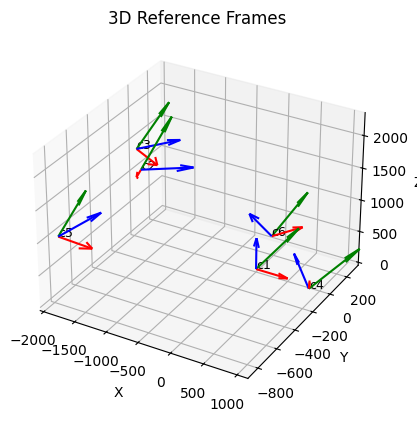

In [32]:
from plotCams3D import plot_frame

# Plot frames
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

for i, T in enumerate(projMat):
    T = np.linalg.inv(T)
    T = np.vstack((T, np.array([0,0,0,1])))
    plot_frame(ax, T, label=cams[i])

# Labels
ax.set_xlabel("X")
ax.set_ylabel("Y")
ax.set_zlabel("Z")
plt.title("3D Reference Frames")
plt.show()
plt.close()

## 2D visualization of original and projected points onto images

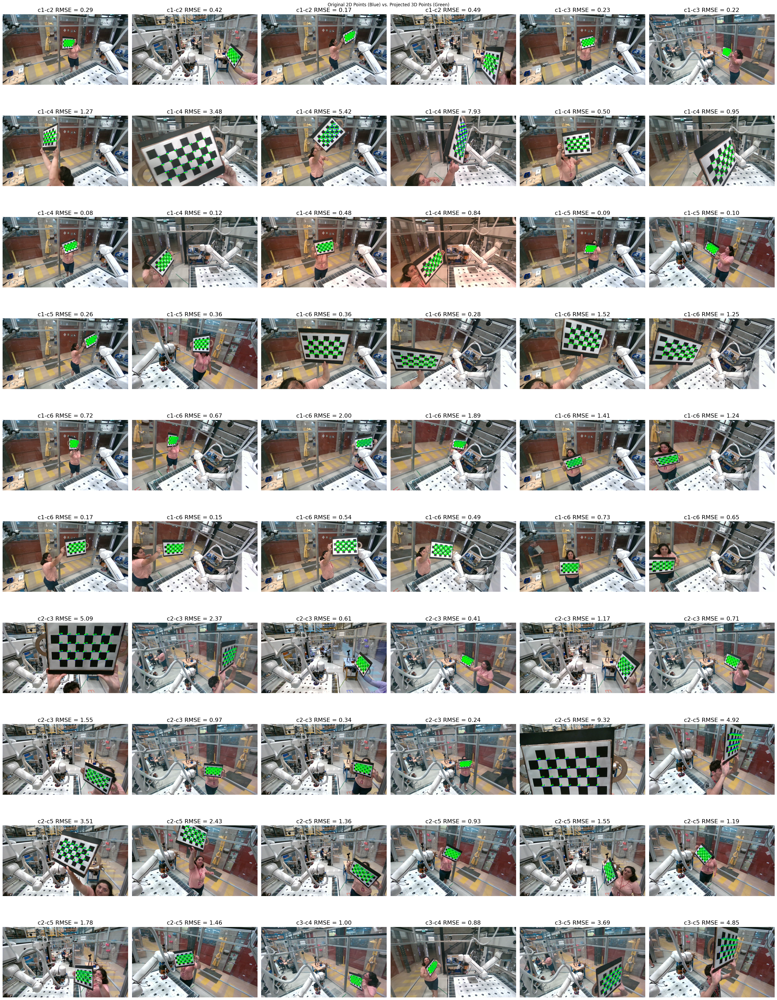

c1-c2 0.47644794
c1-c3 0.4187331
c1-c4 2.049825
c1-c5 0.22366904
c1-c6 0.91777474
c2-c3 2.3405426
c2-c5 2.3565283
c3-c4 0.7936501
c3-c5 1.486314
c3-c6 0.89298296
c4-c5 0.8019517
c4-c6 1.3886306
c5-c6 0.3848639
RMSE total -- Mean: 1.1178395748138428, Median: 0.8929829597473145


In [40]:
def draw_circles(img, pts_2d_original, pts_2d_projected, text=True):

    pts_2d_original = pts_2d_original.reshape(-1,2)
    pts_2d_projected = pts_2d_projected.reshape(-1,2)
    
    for p in range(len(pts_2d_original)):
        x_orig, y_orig = map(int, pts_2d_original[p])  # Original 2D point
        cv2.circle(img, (x_orig, y_orig), 8, (255, 0, 0), -1)

        if pts_2d_projected is not None:
            x_proj, y_proj = map(int, pts_2d_projected[p])  # Reprojected 3D point
            cv2.circle(img, (x_proj, y_proj), 8, (0, 255, 0), -1)
            cv2.line(img, (x_orig, y_orig), (x_proj, y_proj), (0, 255, 255), 2)

        if text:
            # Add labels
            cv2.putText(img, str(p + 1), (x_orig + 10, y_orig), cv2.FONT_HERSHEY_SIMPLEX, 
                        0.6, (255, 0, 0), 2, cv2.LINE_AA)
            cv2.putText(img, str(p + 1), (x_proj + 10, y_proj), cv2.FONT_HERSHEY_SIMPLEX, 
                        0.6, (0, 255, 0), 2, cv2.LINE_AA)
        
    return img

projMat_copy = []
for mat in projMat:
    projMat_copy.append(np.linalg.inv(mat)[0:3,:])

projMat = projMat_copy

K = K_conf
D = D_conf

RMSE = []
rmse_per_cam = {}
for cam1 in cams:
    for cam2 in cams[cams.index(cam1):]:
        rmse_per_cam.update({f'{cam1}-{cam2}': []})

fig, axs = plt.subplots(10, 6, figsize=(30, 40))
axs = axs.flat
k = 0

points_array = []

for i in range(0, len(stereo_images['Camera']) - 1, 2):
    j = i+1 # stereo image is the next one

    pts1_im = stereo_images['Charuco_Corners'][i].squeeze()
    pts2_im = stereo_images['Charuco_Corners'][j].squeeze()

    #Lids = stereo_images['Charuco_Ids'][i].squeeze()
    #Rids = stereo_images['Charuco_Ids'][j].squeeze()

    c1 = cams.index(f'{stereo_images['Camera'][i]}')
    c2 = cams.index(f'{stereo_images['Camera'][j]}')
    
    undist_pts1 = cv2.undistortPoints(pts1_im, K[c1], D[c1]).reshape(-1, 2)  # Shape (2, N)
    undist_pts2 = cv2.undistortPoints(pts2_im, K[c2], D[c2]).reshape(-1, 2)  # Shape (2, N)

    obj_pts = Board.objpoints
    #img_pts_l, img_pts_r = img_pts_l.squeeze(), img_pts_r.squeeze()
    #ids_to_keepL = [list(Lids).index(t) for t in common_ids]
    #ids_to_keepR = [list(Rids).index(t) for t in common_ids]

    # Perform triangulation
    pts_4d = cv2.triangulatePoints(projMat[c1], projMat[c2], undist_pts1.T, undist_pts2.T)
    points_3d = pts_4d[:3, :] / pts_4d[3, :]  # Shape (3, N)
    points_3d = points_3d.T  # Shape (N, 3)

    points_array.append(points_3d)

    img_path1 = os.path.join(calib_dir, stereo_images['Camera'][i], stereo_images['Name'][i])
    img_path2 = os.path.join(calib_dir, stereo_images['Camera'][j], stereo_images['Name'][j])

    # Visualize original and reprojected points (image 1)
    img = cv2.imread(img_path1)

    pts_2d_projected, _ = cv2.projectPoints(points_3d, projMat[c1][0:3,0:3], projMat[c1][0:3,3], K[c1], D[c1])
    pts_2d_projected = pts_2d_projected.squeeze()
    rmse1 = Calib.compute_rmse(pts1_im, points_3d, projMat[c1], K[c1], D[c1])

    if i % 10 == 0 and k < len(axs):
        img = draw_circles(img, pts1_im, pts_2d_projected)
        axs[k].imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
        axs[k].axis('off')
        axs[k].set_title(f'{cams[c1]}-{cams[c2]} RMSE = {rmse1:.2f}', fontsize=16)

    # Visualize original and reprojected points (image 2)
    img = cv2.imread(img_path2)
    
    pts_2d_projected, _ = cv2.projectPoints(points_3d, projMat[c2][0:3,0:3], projMat[c2][0:3,3], K[c2], D[c2])
    pts_2d_projected = pts_2d_projected.squeeze()
    rmse2 = Calib.compute_rmse(pts2_im, points_3d, projMat[c2], K[c2], D[c2])

    if i % 10 == 0 and k < len(axs):
        img = draw_circles(img, pts2_im, pts_2d_projected)
        axs[k+1].imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
        axs[k+1].axis('off')
        axs[k+1].set_title(f'{cams[c1]}-{cams[c2]} RMSE = {rmse2:.2f}', fontsize=16)
        k += 2

    rmse_per_cam[f'{cams[c1]}-{cams[c2]}'] += [rmse1, rmse2]

fig.suptitle("Original 2D Points (Blue) vs. Projected 3D Points (Green)")
fig.tight_layout()
plt.show()
plt.close()

mean_RMSE = []
for key, vals in rmse_per_cam.items():
    if not np.isnan(vals).all():
        m = np.mean(vals)
        print(key, m)
        mean_RMSE.append(m)

print(f'RMSE total -- Mean: {np.mean(mean_RMSE)}, Median: {np.median(mean_RMSE)}')

In [41]:
extrinsics = np.load('Extrinsics_optimized.npz')['arr_0']
np.savez('Extrinsics_optimized_0506.npz', extrinsics[1:])

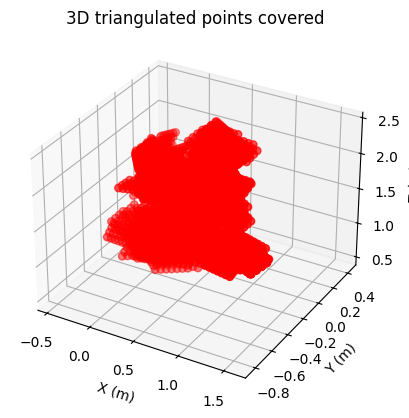

In [34]:
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

points_array = np.vstack(points_array)
points_array_m = points_array / 1000

np.savez('Points3D.npz', points_array_m)

ax.scatter(points_array_m[:, 0], points_array_m[:, 1], points_array_m[:, 2],
           c='red', marker='o', s=30)

ax.set_xlabel('X (m)')
ax.set_ylabel('Y (m)')
ax.set_zlabel('Z (m)')
ax.set_title('3D triangulated points covered')
plt.show()